In [22]:
import numpy as np
from matplotlib import pyplot as plt
import glob
from IPython.display import HTML
from matplotlib.animation import FuncAnimation
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 100
img_dir = '/Users/harry/Documents/p3378/images_for_whatever'

<font size="5">We want to look at images at differend delay times (between the first peak in X-ray pulse train and the strobe/image). These were systematically varied in runs 232-243</font>

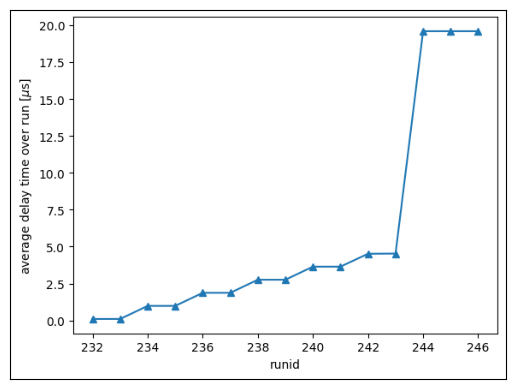

In [44]:
mplot([f'{img_dir}/time_delay_varied.png'])

<font size="5">Examples of two different delay times. Left image shows a droplet exploding after interacting with the first peak in the X-ray pulse train (droplets below are not perturbed). Right image (later time delay) show droplets that have been hit by multiple X-ray pulses.</font>

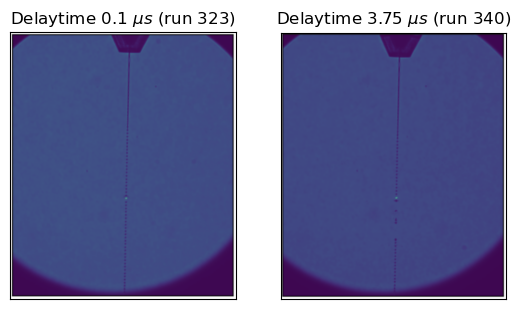

In [45]:
mplot([f'{img_dir}/roi_complete.png',f'{img_dir}/roi_complete_large_delay.png'],[r'Delaytime 0.1 $\mu s$ (run 323)',r'Delaytime 3.75 $\mu s$ (run 340)'])

<font size="5">I began by looking at run 323 (clustering is less complicated without "messy" droplets below the bright yellow spot).<br><br>
Step 1: Crop images and make binary to enhance the embedding algorithm</font>

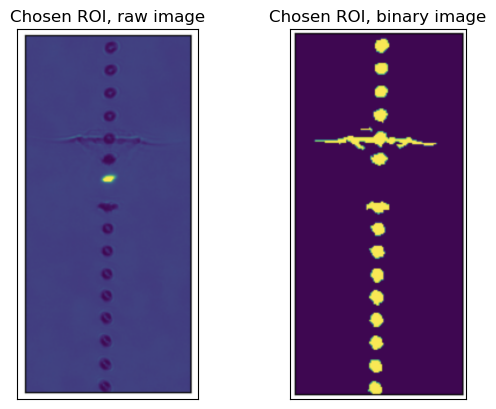

In [49]:
mplot([f'{img_dir}/roi_chosen.png',f'{img_dir}/binary_example.png'],['Chosen ROI, raw image','Chosen ROI, binary image'])

<font size="5">
Step 2: t-sne embedding. Each point represent an image</font>

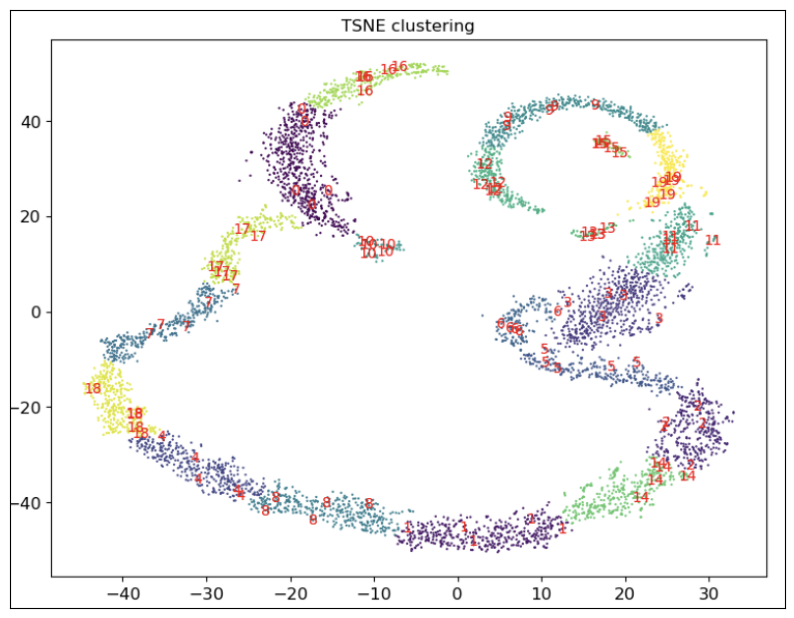

In [61]:
mplot([f'{img_dir}/initial_cluster.png'],size=4)

<font size="5">
Step 3: Look at class averages. Now we can remove "unwanted" classes (like 12,9,19), and make a new embedding on only the relevant images</font>

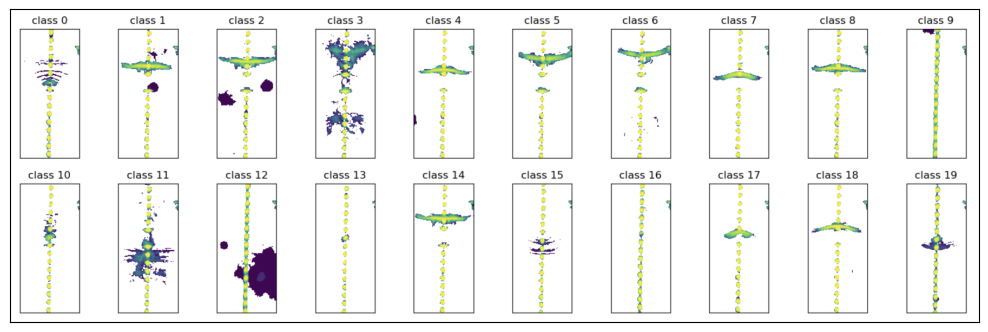

In [59]:
mplot([f'{img_dir}/initial_class_averages.png'],size=5)

<font size="5">
Step 4: Cluster again using only the "interesting images"</font>

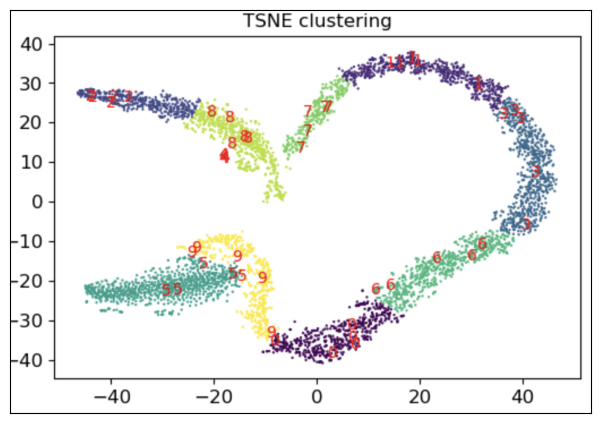

In [66]:
mplot([f'{img_dir}/second_iteration_cluster.png'],size=3)

<font size="5">
Step 5: To visualize the time evolution, we can define a trajectory to walk along, looking at closeby images</font>

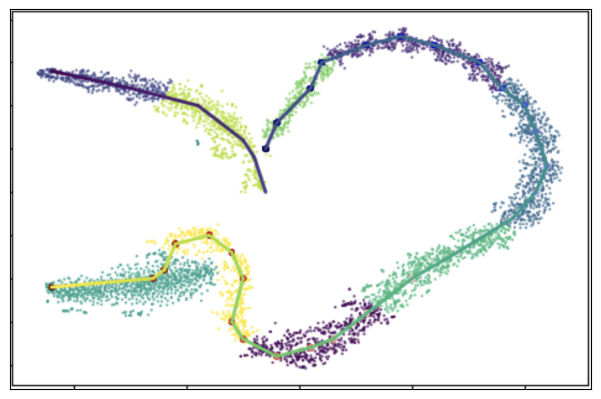

In [72]:
mplot([f'{img_dir}/set_trajectory.png'],size=3)

<font size="5">
Step 6: Visualize the results (Move slider to show evolution)</font>

In [85]:
fig = plt.figure()
ax = fig.add_subplot()
filenames = sorted(glob.glob('/Users/harry/Documents/ice_project/set_0/img*'))[::6]
ani = FuncAnimation(fig, update, frames=filenames, interval=150, repeat=False)
display(HTML(ani.to_jshtml()))
plt.close()

<font size="5">
<b>What I want to try:</b> comparing t<sub>i</sub> and t<sub>f</sub> below, we see shift &Delta;x<sub>droplet</sub> of the droplets and &Delta;x<sub>wave</sub> of the shockwave.</font>

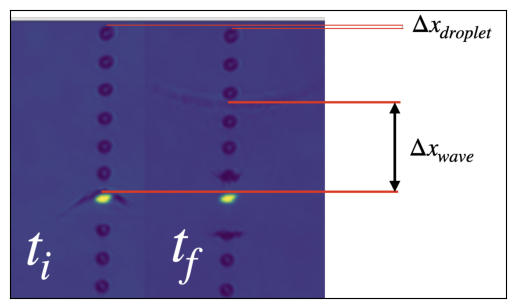

In [78]:
mplot([f'{img_dir}/dxdx.png'])

<font size="5">
We should be able to relate this (given that we know droplet velocity v<sub>droplet</sub>) to the shockwave velocity</font>

$$
v_{\text{wave}} = \frac{\Delta x_{\text{wave}}}{\Delta x_{\text{droplet}}} v_{\text{droplet}}
$$

<font size="5">
Using image analysis and statistics from many images, I think we can estimate both &Delta;x<sub>droplet</sub> and &Delta;x<sub>wave</sub> with high accuracy.</font>

<font size="5">
Comment: why do we see shockwaves at different positions, even though the delay between X-ray and strobe is constant? This should be (we think) due to the random jitter delay of the strobe, which is between 0 and 0.00923 &mu;s</font>

In [57]:
def update(filenames):
    ax.cla()
    ax.imshow(plt.imread(filenames))

def mplot(imgs,titles=None,size=None):
    if len(imgs)>1:
        if type(size) == int:
            fig,ax=plt.subplots(1,len(imgs),figsize=(size*2.5,size*5))
        else:
            fig,ax=plt.subplots(1,len(imgs))
        for i in list(range(len(imgs))):
            ax[i].imshow(plt.imread(imgs[i]))
            ax[i].set_yticks([])
            ax[i].set_xticks([])
            if type(titles)==list:
                ax[i].set_title(titles[i])
    else:
        if type(size) == int:
            fig,ax=plt.subplots(figsize=(size*2.5,size*5))
        else:
            fig,ax=plt.subplots()
        ax.imshow(plt.imread(imgs[0]))
        ax.set_yticks([])
        ax.set_xticks([])
        if type(titles) == list:
            ax.set_title(titles[0])

In [82]:
import numpy as np
from matplotlib import pyplot as plt
import glob
from IPython.display import HTML
from matplotlib.animation import FuncAnimation
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 100
img_dir = '/Users/harry/Documents/p3378/images_for_whatever'